In [1]:
import numpy as np
import pandas as pd
import seaborn as sns

%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [2]:
df = pd.read_csv('/Users/kimginam/ML/Linear Regression/Melbourne_housing_FULL.csv')

In [3]:
df.reset_index(inplace = True)

In [4]:
df.head()

,index,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   index          34857 non-null  int64  
 1   Suburb         34857 non-null  object 
 2   Address        34857 non-null  object 
 3   Rooms          34857 non-null  int64  
 4   Type           34857 non-null  object 
 5   Price          27247 non-null  float64
 6   Method         34857 non-null  object 
 7   SellerG        34857 non-null  object 
 8   Date           34857 non-null  object 
 9   Distance       34856 non-null  float64
 10  Postcode       34856 non-null  float64
 11  Bedroom2       26640 non-null  float64
 12  Bathroom       26631 non-null  float64
 13  Car            26129 non-null  float64
 14  Landsize       23047 non-null  float64
 15  BuildingArea   13742 non-null  float64
 16  YearBuilt      15551 non-null  float64
 17  CouncilArea    34854 non-null  object 
 18  Lattit

In [6]:
df.shape

(34857, 22)

In [7]:
df.columns

Index(['index', 'Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method',
       'SellerG', 'Date', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom',
       'Car', 'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea',
       'Lattitude', 'Longtitude', 'Regionname', 'Propertycount'],
      dtype='object')

In [8]:
df[df['Regionname'].isnull()]

,index,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
18523,18523,Footscray,2/16 Stafford St,2,u,710000.0,S,Jas,15/07/2017,5.1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26888,26888,Camberwell,2/3 Kingsley St,2,h,825000.0,VB,Jellis,11/11/2017,7.7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29483,29483,Fawkner Lot,1/3 Brian St,3,h,616000.0,SP,Brad,6/01/2018,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
df = df.drop([29483,18443,25717,27390,27391,2536,26210,12043,12043,27150,6017,25839,12539,19583,25635])

In [10]:
df.loc[18523,'Regionname']='Western Metropolitan'
df.loc[26888,'Regionname']='Southern Metropolitan'

In [11]:
df['Regionname'].isnull().any()

False

In [12]:
df['Regionname'] = df['Regionname'].map({'Southern Metropolitan':0, 'Northern Metropolitan':1, 'Western Metropolitan':2, 'Eastern Metropolitan':3
                                        , 'South-Eastern Metropolitan':4, 'Eastern Victoria':7, 'Northern Victoria':6, 'Western Victoria':5}).astype(int)

In [13]:
df = df.drop(['SellerG', 'CouncilArea', 'Date'], axis=1)

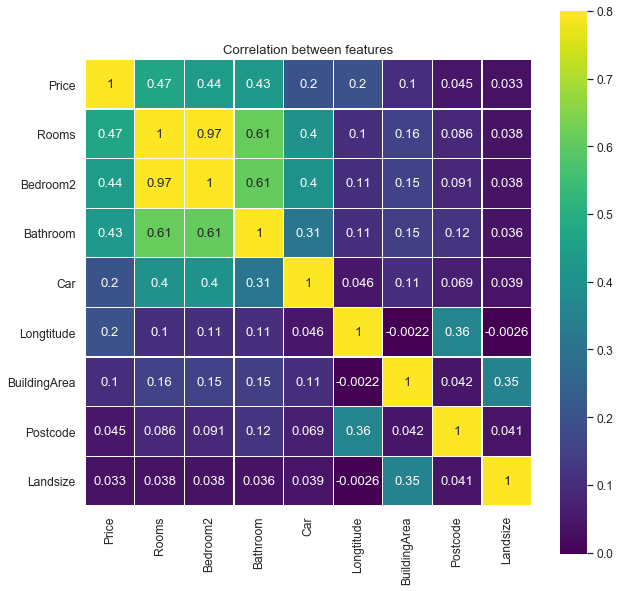

In [14]:
corrMatrix=df[["Price","Rooms","Bedroom2","Bathroom",
"Car","Longtitude","BuildingArea","Postcode","Landsize"]].corr()
sns.set(font_scale=1.10)
plt.figure(figsize=(10, 10))
sns.heatmap(corrMatrix, vmax=.8, linewidths=0.01,
square=True,annot=True,cmap='viridis',linecolor="white")
plt.title('Correlation between features');

In [15]:
corr_matrix = df.corr()
corr_matrix["Price"].sort_values(ascending=False)

Price            1.000000
Rooms            0.468617
Bedroom2         0.437190
Bathroom         0.431596
Car              0.203071
Longtitude       0.198770
BuildingArea     0.101258
Postcode         0.044741
Landsize         0.032763
index           -0.046216
Propertycount   -0.059458
Distance        -0.214164
Lattitude       -0.216726
Regionname      -0.237854
YearBuilt       -0.334883
Name: Price, dtype: float64

In [16]:
df['Bedroom2'].isnull().sum()

8216

In [17]:
fre = df['Bedroom2'].mode()[0]
df['Bedroom2'] = df['Bedroom2'].fillna(fre)

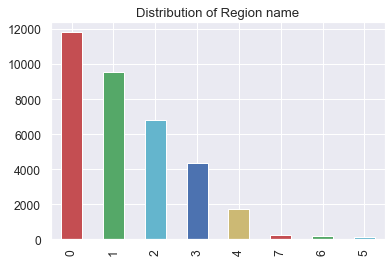

In [18]:
plt.title('Distribution of Region name')
df['Regionname'].value_counts().plot.bar(color=('r', 'g', 'c', 'b', 'y'))

In [19]:
import plotly.graph_objs as go
def horizontal_bar_chart(cnt_srs, color):
    trace = go.Bar(
        y=cnt_srs.index[::-1],
        x=cnt_srs.values[::-1],
        showlegend=False,
        orientation = 'h',
        marker=dict(
        color=color,
        ),
    )
    return trace
cnt_srs = df.groupby('Type')['Price'].agg(['mean'])
cnt_srs.columns = ["mean"]
cnt_srs = cnt_srs.sort_values(by="mean", ascending=False)
trace0 = horizontal_bar_chart(cnt_srs['mean'], 'rgba(20, 71, 20, 0.6)')
layout = go.Layout(title = 'Region name by Distance')
fig = go.Figure(data = trace0, layout = layout)
fig

In [20]:
df['Bathroom'].isnull().sum()

8225

In [21]:
fre = df['Bathroom'].mode()[0]
df['Bathroom'] = df['Bathroom'].fillna(fre)

Text(0.5, 1, 'Correlation between Distance and Price')

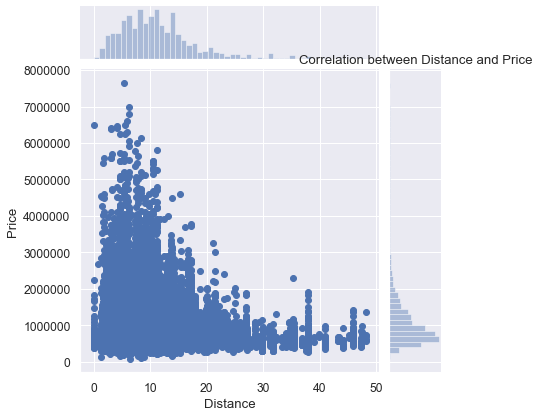

In [22]:
sns.jointplot(x='Distance', y='Price', data=df[df['Price'] > 10])
plt.title('Correlation between Distance and Price')

In [23]:
cnt_srs = df['Price'].value_counts()
trace1 = go.Scatter(
    x = cnt_srs.index,
    y = cnt_srs.values,
    mode = "markers",
    marker = dict(color = 'rgba(200, 50, 55, 0.8)')
)
data = [trace1]
layout = dict(title = 'Distribution of Price',
xaxis= dict(title= 'Price per house',ticklen= 5,zeroline= False)
)
fig = go.Figure(data = data, layout = layout)
fig

In [24]:
df.head()

,index,Suburb,Address,Rooms,Type,Price,Method,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Regionname,Propertycount
0,0,Abbotsford,68 Studley St,2,h,NaN,SS,2.5,3067.0,2.0,1.0,1.0,126.0,NaN,NaN,-37.8014,144.9958,1,4019.0
1,1,Abbotsford,85 Turner St,2,h,1480000.0,S,2.5,3067.0,2.0,1.0,1.0,202.0,NaN,NaN,-37.7996,144.9984,1,4019.0
2,2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,2.5,3067.0,2.0,1.0,0.0,156.0,79.0,1900.0,-37.8079,144.9934,1,4019.0
3,3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,2.5,3067.0,3.0,2.0,1.0,0.0,NaN,NaN,-37.8114,145.0116,1,4019.0
4,4,Abbotsford,5 Charles St,3,h,1465000.0,SP,2.5,3067.0,3.0,2.0,0.0,134.0,150.0,1900.0,-37.8093,144.9944,1,4019.0


In [25]:
df['Lat'] = df['Lattitude'].dropna()
df['Long'] = df['Longtitude'].dropna()

In [26]:
df['Long'].head()

0    144.9958
1    144.9984
2    144.9934
3    145.0116
4    144.9944
Name: Long, dtype: float64

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 34843 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   index          34843 non-null  int64  
 1   Suburb         34843 non-null  object 
 2   Address        34843 non-null  object 
 3   Rooms          34843 non-null  int64  
 4   Type           34843 non-null  object 
 5   Price          27235 non-null  float64
 6   Method         34843 non-null  object 
 7   Distance       34843 non-null  float64
 8   Postcode       34843 non-null  float64
 9   Bedroom2       34843 non-null  float64
 10  Bathroom       34843 non-null  float64
 11  Car            26116 non-null  float64
 12  Landsize       23035 non-null  float64
 13  BuildingArea   13737 non-null  float64
 14  YearBuilt      15544 non-null  float64
 15  Lattitude      26868 non-null  float64
 16  Longtitude     26868 non-null  float64
 17  Regionname     34843 non-null  int64  
 18  Proper

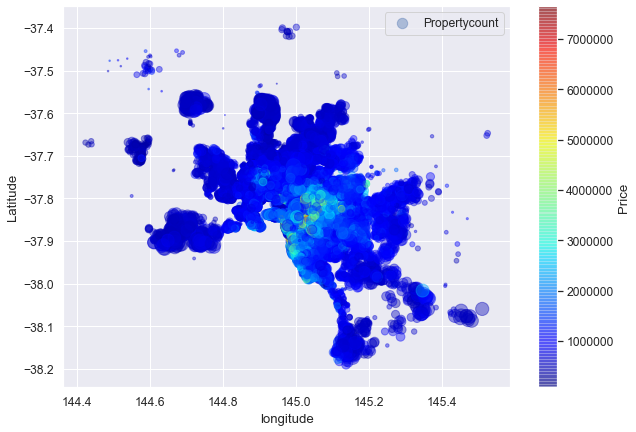

In [28]:
ax = df.plot(kind="scatter", x="Long", y="Lat", alpha=0.4,
    s=df["Propertycount"]/100, label="Propertycount", figsize=(10,7),
    c="Price", cmap=plt.get_cmap("jet"), colorbar=True,
    sharex=False)
ax.set(xlabel='longitude', ylabel='Latitude')
plt.legend()

In [29]:
df.loc[18523,'Propertycount']=7570.0
df.loc[26888,'Propertycount']=8920.0

In [30]:
fre = df['Lat'].mode()[0]
df['Lat'] = df['Lat'].fillna(fre)

In [31]:
fre = df['Long'].mode()[0]
df['Long'] = df['Long'].fillna(fre)

In [32]:
import folium
from folium import plugins
map1 = folium.Map(location=[-37.8014, 144.9958], zoom_start=5)
markers = []
for n in df.index:
    folium.CircleMarker([df['Lat'][n], df['Long'][n]], radius = df['Propertycount'][n]*0.00003, color='#ef4f61', fill=True).add_to(map1)
map1

In [33]:
df['pricepie'] = np.where(df.Price > 1, '1','0')

In [34]:
from plotly.offline import init_notebook_mode, iplot
cnt_ = df['pricepie'].value_counts()
fig = {
"data": [
{
"values": cnt_.values,
"labels": cnt_.index,
"domain": {"x": [0, .5]},
"name": "Train types",
"hoverinfo":"label+percent+name",
"hole": .7,
"type": "pie"
},],
"layout": {
"title":"NaN of Price ",
"annotations": [
{ "font": { "size": 20},
"showarrow": False,
"text": "Pie Chart",
"x": 0.50,
"y": 1
},
]
}
}
iplot(fig)

In [35]:
df = df.drop(['pricepie', 'Lattitude', 'Longtitude', 'Method'],axis=1)

In [36]:
df['Price'] = df['Price'].fillna(method='ffill')

In [37]:
df.loc[0,'Price']=1480000.0

In [38]:
df['Price'].isnull().sum()

0

In [39]:
cnt_srs = df['Price'].value_counts()
trace1 = go.Scatter(
    x = cnt_srs.index,
    y = cnt_srs.values,
    mode = "markers",
    marker = dict(color = 'rgba(200, 50, 55, 0.8)')
)
data = [trace1]
layout = dict(title = 'Distribution of Price after missing value processing',
xaxis= dict(title= 'Price per house',ticklen= 5,zeroline= False)
)
fig = go.Figure(data = data, layout = layout)
fig